In [1]:
import os, sys
sys.path.append(r'/Users/khcho/Desktop/IRIS-moss-main/iris2plus/iris_lmsalpy')

import joblib
import gzip, pickle
import matplotlib.pyplot as plt
import glob, os, pdb
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.io import readsav
from scipy import stats
import xarray as xr
xr.set_options(keep_attrs=True)
import astropy.time as time 

plt.rcParams["image.origin"] = 'lower'
plt.rcParams["image.interpolation"] = 'none'
plt.rcParams["image.aspect"] = 'auto'

# Load the joblib file
file_path = '/Users/khcho/Desktop/IRIS-moss-main/iris2plus/chro_photo/'
save_path = file_path+'analysis/'
os.chdir(file_path)

In [2]:
good_iris2p_moss = xr.open_zarr(file_path+'good_iris2p_moss.zarr').compute()

In [3]:
good_iris2p_moss

<xarray.Dataset> Size: 154MB
Dimensions:          (Gaussian_params: 4, moss_no: 391, time: 241, log_tau: 39,
                      line_center: 12, line_width: 12)
Coordinates:
  * Gaussian_params  (Gaussian_params) <U9 144B 'const' 'amplitude' ... 'sigma'
  * line_center      (line_center) float64 96B 1.335e+03 1.336e+03 ... 2.827e+03
  * line_width       (line_width) float64 96B 0.25 0.25 0.1 ... 0.1 0.1 0.05
  * log_tau          (log_tau) float64 312B -7.6 -7.4 -7.2 ... -0.4 -0.2 0.0
  * moss_no          (moss_no) int64 3kB 27 39 45 46 57 ... 1627 1628 1629 1630
  * time             (time) float64 2kB -60.0 -59.5 -59.0 ... 59.0 59.5 60.0
Data variables: (12/15)
    IRIS2+files      (moss_no) <U115 180kB '/Users/khcho/Desktop/IRIS-moss-ma...
    IRISlv2_files    (moss_no) <U115 180kB '/irisa/data/level2/2015/09/16/201...
    R_loss           (time, moss_no) float64 754kB 24.91 17.84 ... 30.95 30.45
    Si_IV_Gaussian   (time, moss_no, Gaussian_params) float64 3MB 0.1611 ... ...
    Si_IV_net_flux   (time, moss_no) float64 754kB 219.5 58.95 ... 58.07 59.79
    Si_IV_v_Dop      (time, moss_no) float64 754kB 10.47 6.307 ... 8.496 7.695
    ...               ...
    percentage       (moss_no) float64 3kB 11.55 11.55 11.55 ... 19.46 19.46
    temperature      (time, log_tau, moss_no) float64 29MB 5.793e+03 ... 5.92...
    time_arg         (time, moss_no) float64 754kB 255.0 583.0 ... 1.111e+03
    time_cadence     (moss_no) float64 3kB 6.0 6.0 6.0 6.0 ... 9.0 9.0 9.0 9.0
    v_los            (time, log_tau, moss_no) float64 29MB 5.436 ... -1.724
    v_tur            (time, log_tau, moss_no) float64 29MB 12.06 12.34 ... 0.0

In [4]:
iris2p_str = '$IRIS^{2+}$'
good_iris2p_moss.Si_IV_net_flux.attrs['label'] = 'Si IV Net Flux'
good_iris2p_moss.Si_IV_v_Dop.attrs['label'] = 'Si IV Doppler Velocity (km s$^{-1}$)'
good_iris2p_moss.Si_IV_v_nth.attrs['label'] = 'Si IV Non-thermal velocity (km s$^{-1}$)'
good_iris2p_moss.temperature.attrs['label'] = iris2p_str+' Temperature (K)'
good_iris2p_moss.v_los.attrs['label'] = iris2p_str+' line of sight velocity (km s$^{-1}$)'
good_iris2p_moss.v_tur.attrs['label'] = iris2p_str+' Turbulent velocity (km s$^{-1}$)'
good_iris2p_moss.n_e.attrs['label'] = iris2p_str+' Electron Density (cm$^3$)'
good_iris2p_moss.R_loss.attrs['label'] = iris2p_str+' Radiative Loss (kW m$^{-2}$)'

temp_diff = good_iris2p_moss.temperature - good_iris2p_moss.temperature.sel(time=slice(-60, -50)).mean(dim='time')
temp_diff.attrs['label'] = iris2p_str+' Temperature difference (K)'             
n_e_diff = good_iris2p_moss.n_e - good_iris2p_moss.n_e.sel(time=slice(-60, -50)).mean(dim='time')
n_e_diff.attrs['label'] = iris2p_str+' Electron density difference (cm$^3$)'             

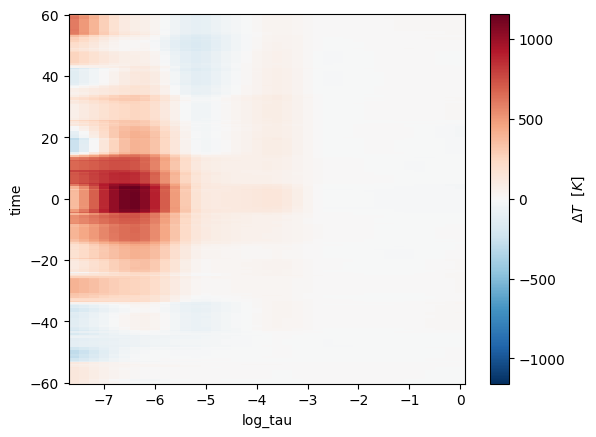

In [5]:
temp_diff.mean(dim='moss_no', skipna=True).plot(
    cbar_kwargs={'label':rf'$\Delta T \ \ [K]$'})

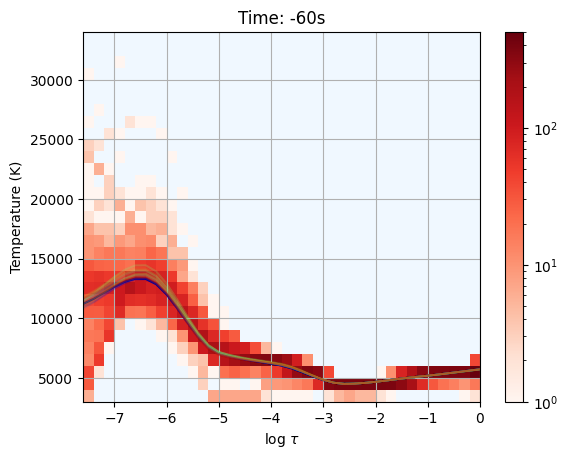

In [135]:
import matplotlib.animation as animation 
import matplotlib as mpl
plt.rcParams["animation.html"] = "jshtml"
time_min = -60
time_max = 60
time_arr = np.arange(time_min, time_max, 2)
ntime = len(time_arr)
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, ntime))
time = 0
fig, ax = plt.subplots()

avg_lines = []

def get_xy(time):
    x = list(good_iris2p_moss.log_tau.values)*good_iris2p_moss.sizes['moss_no']
    y = good_iris2p_moss.temperature.sel(time=time, method='nearest').T.values.flatten()
    idx = np.isfinite(x) & np.isfinite(y)
    return np.array(x)[idx], np.array(y)[idx]

def animate(time):
    ax.set_title(f'Time: {time}s')
    # for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    for child in ax.get_children():
        if isinstance(child, mpl.collections.QuadMesh):
            child.remove()
    x, y = get_xy(time)
    # hist2d.remove()
    hist2d = ax.hist2d(x, y, bins=[good_iris2p_moss.log_tau, np.arange(3000, 35000, 1000)], 
                  norm=mpl.colors.LogNorm(1, 5e2), cmap='Reds') 
    for ii in avg_lines:
        ii[0].set_alpha(0.05)
    avg_lines[np.argmin(abs(time_arr-time))][0].set_alpha(1)

numframes = 10
# for ii, lgt in enumerate(range(lgt_min, lgt_max)):
x, y = get_xy(time)
hist2d = ax.hist2d(x, y, bins=[good_iris2p_moss.log_tau, np.arange(3000, 35000, 1000)], 
                  norm=mpl.colors.LogNorm(1, 5e2), cmap='Reds') 
coeff = np.polyfit(x, y, 1)
pearson_c = stats.pearsonr(x, y).statistic
poly1d_fn = np.poly1d(coeff)
xmin, xmax = (min(x), max(x))
    # plt.plot([xmin, xmax], poly1d_fn([xmin, xmax]), '-', color=colors[ii], alpha=0.5)
    # print(rf'({lgt} < log $\tau $ < {lgt+1})  slope: {coeff[0]:6.2f}, $\rho$: {pearson_c:5.2f}')
ax.set(xlabel=r'log $\tau$', ylabel='Temperature (K)', aspect='auto', title=f'Time: {time}s', facecolor='aliceblue')
cb1 = fig.colorbar(hist2d[3])
ax.grid()
for ii, time in enumerate(range(-60, 60, 2)):
    data = good_iris2p_moss.temperature.sel(time=time, method='nearest').mean(dim='moss_no')
    p01 = ax.plot(good_iris2p_moss.log_tau, data, color=colors[ii], alpha=0.05)
    avg_lines.append(p01)

ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani.save(filename=save_path+'T_loga_tau_2dhist.mp4', writer='ffmpeg', dpi=200)

animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)



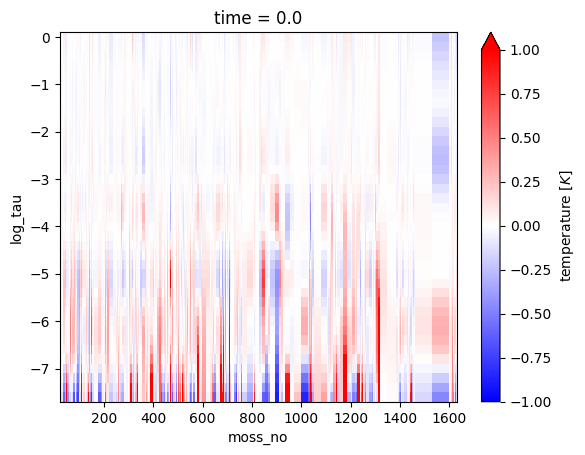

In [151]:
pre_temp = good_iris2p_moss.temperature.sel(time=slice(-60, -50)).mean(dim='time')
temp_diff_ratio = ((good_iris2p_moss.temperature.sel(time=0) - pre_temp)/pre_temp)
temp_diff_ratio.plot(vmin=-1, vmax=1, cmap='bwr')

-0.5950254643826106
0.3141481031912489


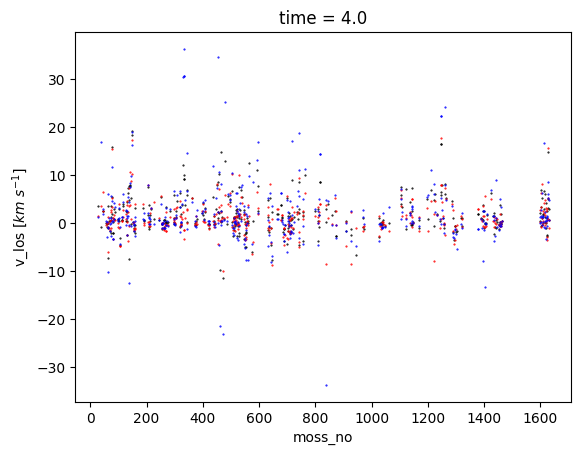

In [220]:
max_loc = temp_diff_ratio.sel(log_tau=slice(-6, -2)).idxmax(dim='log_tau')
# max_loc
dtau = 0.6
kwarg = {'ms':1, 'marker':'.', 'linestyle':' ', 'alpha':1}
cen = good_iris2p_moss.sel(time=0, log_tau=max_loc, method='nearest').v_los

cen.plot(color='k', **kwarg)
lower = good_iris2p_moss.sel(time=4, log_tau=max_loc+dtau, method='nearest').v_los
lower.plot(color='r', **kwarg)

upper = good_iris2p_moss.sel(time=4, log_tau=max_loc-dtau, method='nearest').v_los
upper.plot(color='b', **kwarg)
# good_iris2p_moss.sel(log_tau=slice(-6, -2)).log_tau[max_loc].plot(marker='o', linestyle=' ')
print((lower-cen).mean().values)
print((upper-cen).mean().values)

In [243]:
moss_no = 1
max_loc.sel(moss_no=27).values+np.arange(-1, 1, 0.2)

array([-4.8, -4.6, -4.4, -4.2, -4. , -3.8, -3.6, -3.4, -3.2, -3. ])

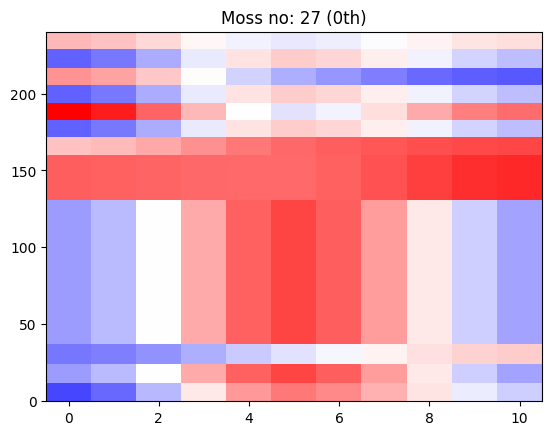

In [273]:
def animate(moss_no_):
    moss_no = good_iris2p_moss.moss_no[moss_no_]
    ax.set_title(f'Moss no: {moss_no.values} ({moss_no_}th)')
    val = good_iris2p_moss.v_los.sel(moss_no=moss_no, 
                               log_tau=max_loc.sel(moss_no=moss_no).values+np.arange(-1, 1.2, 0.2), method='nearest').values
    im01.set_data(val)
    
# for moss_no in good_iris2p_moss.moss_no:
fig, ax = plt.subplots()
moss_no = good_iris2p_moss.moss_no[0]
val = good_iris2p_moss.v_los.sel(moss_no=moss_no, 
                               log_tau=max_loc.sel(moss_no=moss_no).values+np.arange(-1, 1.2, 0.2), method='nearest').values
im01 = ax.imshow(val, cmap='bwr')
ax.set(aspect = 'auto', xlabel=r'log $\tau$', ylabel='Time', extend=[)


animation.FuncAnimation(fig, animate, frames=len(good_iris2p_moss.moss_no), interval=1e2)

2.010866238301855


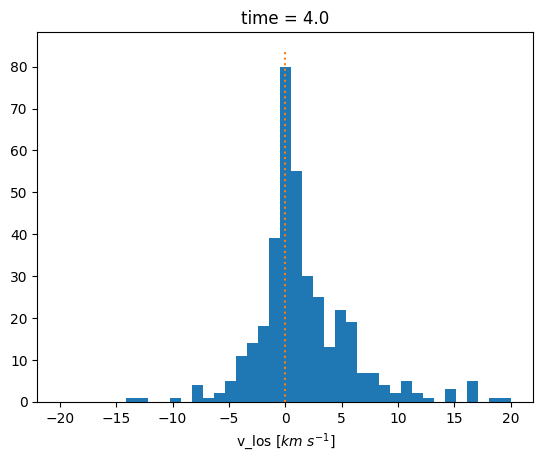

In [223]:
print(upper.mean().values)
_ = upper.plot.hist(bins=41, range=[-20, 20])
_ = plt.plot([0, 0], plt.gca().get_ylim(), ':')

1.101692670727996


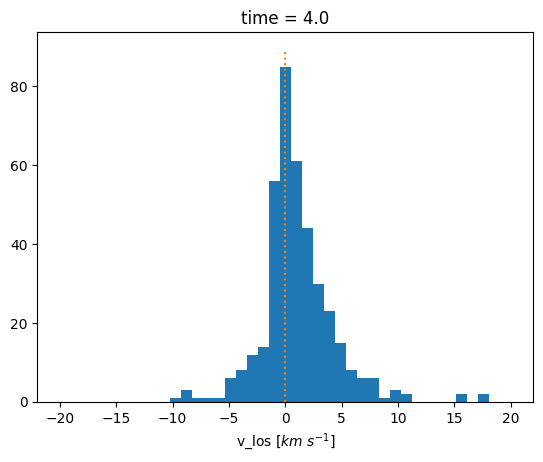

In [227]:
print(lower.mean().values)
_ = lower.plot.hist(bins=41, range=[-20, 20])
_ = plt.plot([0, 0], plt.gca().get_ylim(), ':')

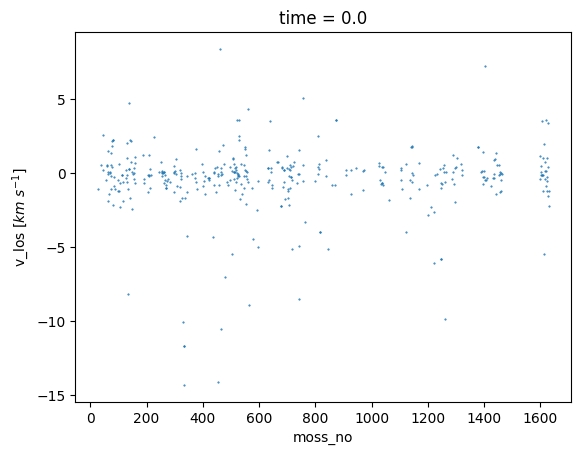

In [197]:
(lower-cen).plot(**kwarg)

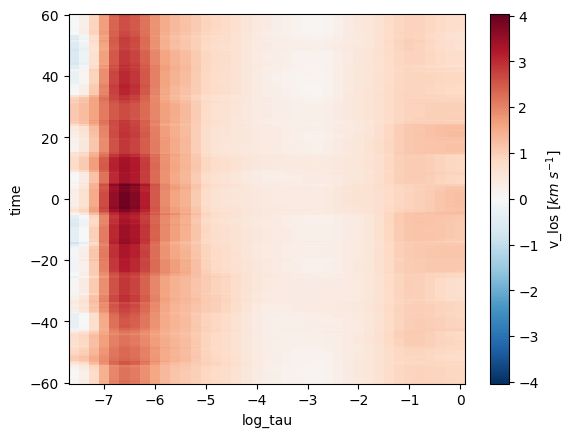

In [6]:
good_iris2p_moss.v_los.mean(dim='moss_no', skipna=True).plot()

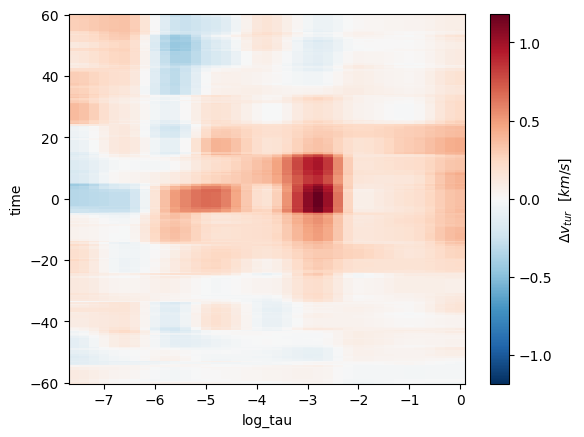

In [7]:
pre_v_tur = good_iris2p_moss.v_tur.sel(time=slice(-60, -50)).mean(dim='time')
(good_iris2p_moss.v_tur - pre_v_tur).mean(dim='moss_no', skipna=True).plot(
    cbar_kwargs={'label':rf'$\Delta v_{{tur}} \ \  [km/s]$'})

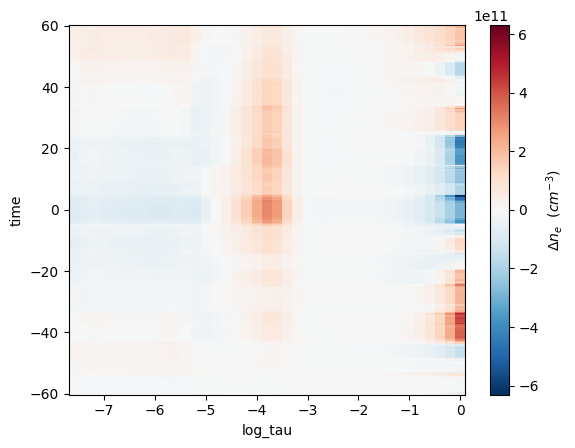

In [18]:
pre_n_e = good_iris2p_moss.n_e.sel(time=slice(-60, -50)).mean(dim='time')
(good_iris2p_moss.n_e - pre_n_e).mean(dim='moss_no', skipna=True).plot(
    cbar_kwargs={'label':rf'$\Delta n_e \ \ (cm^{{-3}})$ '}
)

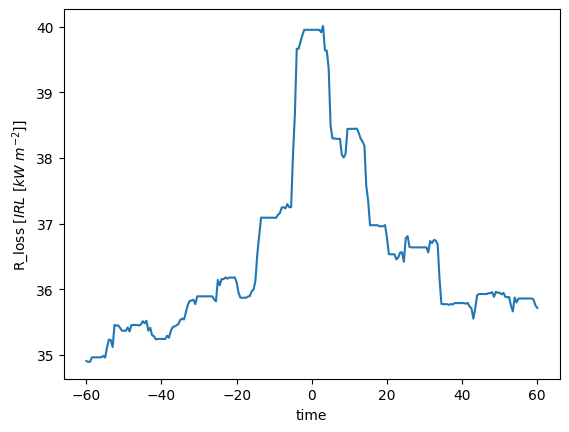

In [8]:
good_iris2p_moss.R_loss.mean(dim='moss_no', skipna=True).plot()

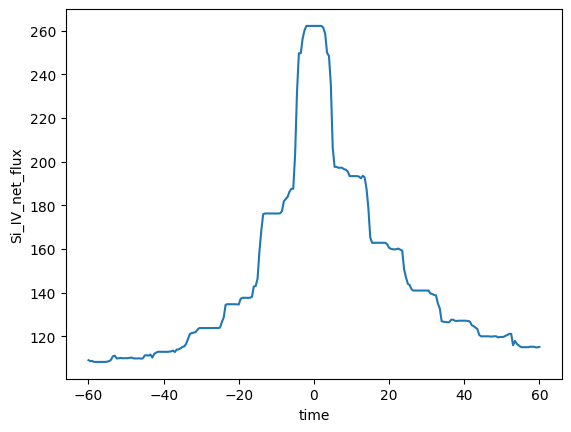

In [9]:
good_iris2p_moss.Si_IV_net_flux.mean(dim='moss_no', skipna=True).plot()

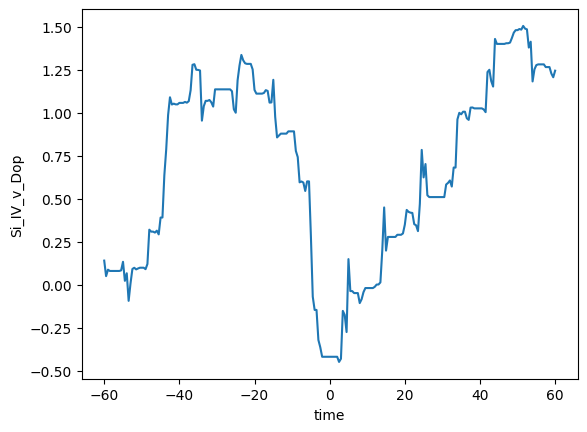

In [10]:
good_iris2p_moss.Si_IV_v_Dop.mean(dim='moss_no', skipna=True).plot()

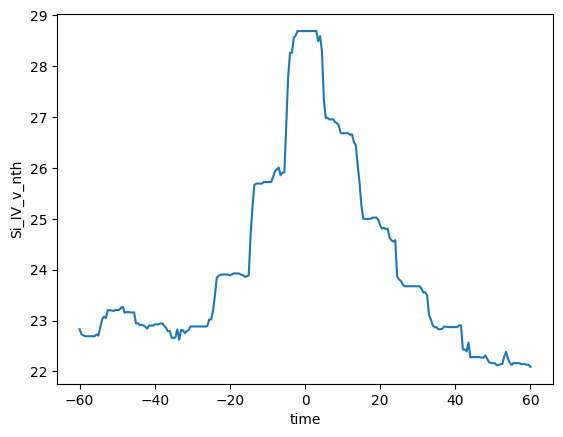

In [11]:
good_iris2p_moss.Si_IV_v_nth.mean(dim='moss_no', skipna=True).plot()

In [59]:
x1 = good_iris2p_moss.sel(time=0, log_tau=slice(lgt_min, lgt_max)).Si_IV_v_Dop[down]

[Text(0.5, 0, 'v$_{Dop, Si\\ IV}$ (km/s)'), Text(0, 0.5, '$\\Delta$ T (K)')]

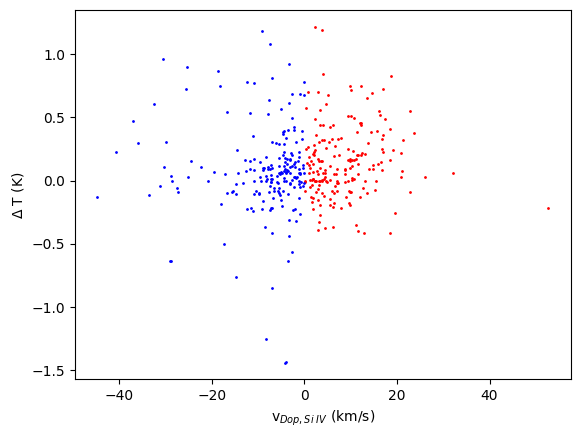

In [81]:
lgt_min = -5
lgt_max = -3
lgt_range = (good_iris2p_moss.log_tau > lgt_min) * (good_iris2p_moss.log_tau > lgt_min)
delta_temp = good_iris2p_moss.temperature - good_iris2p_moss.temperature.sel(time=-60)
down = good_iris2p_moss.Si_IV_v_Dop.sel(time=0) > 0
x1 = good_iris2p_moss.sel(time=0).Si_IV_v_Dop[down]
y1 = delta_temp.sel(time=0, log_tau=slice(lgt_min, lgt_max)).mean(dim='log_tau')[down]
plt.scatter(x1, y1, s=1, c='red')
up = good_iris2p_moss.Si_IV_v_Dop.sel(time=0) < 0
x2 = good_iris2p_moss.sel(time=0).Si_IV_v_Dop[up]
y2 = delta_temp.sel(time=0, log_tau=slice(lgt_min, lgt_max)).mean(dim='log_tau')[up]
plt.scatter(x2, y2, s=1, c='blue')
plt.gca().set(xlabel=rf'v$_{{Dop, Si\ IV}}$ (km/s)', ylabel=rf'$\Delta$ T (K)')

In [37]:
from scipy.stats import pearsonr
lgt_min = -8
lgt_max = -3
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))

pearson_dop_dop = np.zeros((good_iris2p_moss.time.size, good_iris2p_moss.log_tau.size))
slope_dop_dop = np.zeros((good_iris2p_moss.time.size, good_iris2p_moss.log_tau.size))
pearson_dop_dop = np.zeros((good_iris2p_moss.time.size, good_iris2p_moss.log_tau.size))
for jj, time in enumerate(good_iris2p_moss.time):
    for ii, lgt in enumerate(good_iris2p_moss.log_tau):
        iris_2p_dop = good_iris2p_moss.v_los.sel(time=time, log_tau=lgt)
        iris_2p_t = good_iris2p_moss.temperature.sel(time=time, log_tau=lgt)
        x = good_iris2p_moss.Si_IV_v_Dop.sel(time=time)
        y = iris_2p_dop
        idx = np.isfinite(x) & np.isfinite(y)
        # plt.scatter(x[idx], y[idx], 
        #             s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
        coeff = np.polyfit(x[idx], y[idx], 1)
        pearson_c[jj, ii] = pearsonr(x[idx], y[idx])[0]
        slope[jj, ii] = coeff[-1]
        # poly1d_fn = np.poly1d(coeff)
        # plt.plot([-100, 100], poly1d_fn([-100, 100]), '-', color=colors[ii], alpha=0.5)
    # plt.gca().set(xlabel='Si IV Doppler velocity', ylabel='IRIS2+ Doppler velocity', 
    #              xlim=[-50, 50], ylim=[-50, 50], aspect='equal')
    # plt.grid()
    # plt.legend()

# matplotlib.animation.FuncAnimation(fig, animate, frames=10)

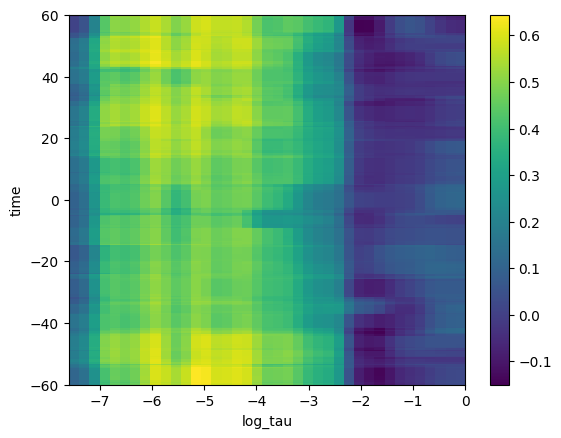

In [39]:
log_tau = good_iris2p_moss.log_tau.values
plt.imshow(pearson_c, extent=[log_tau[0], log_tau[-1], -60, 60], interpolation='none')
plt.gca().set(aspect='auto', xlabel='log_tau', ylabel='time')
plt.colorbar()

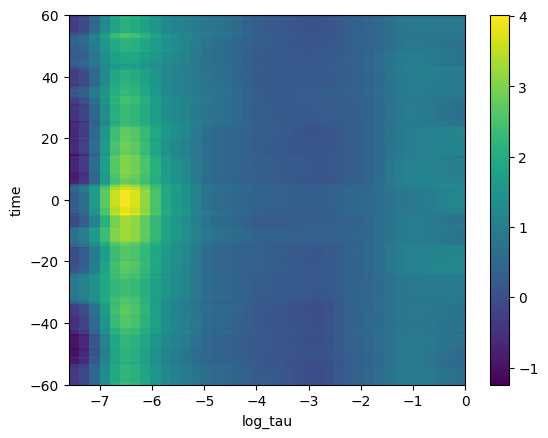

In [40]:
plt.imshow(slope, extent=[log_tau[0], log_tau[-1], -60, 60], interpolation='none')
plt.gca().set(aspect='auto', xlabel='log_tau', ylabel='time')
plt.colorbar()

In [86]:
good_iris2p_moss

<xarray.Dataset> Size: 131MB
Dimensions:          (Gaussian_params: 4, moss_no: 408, time: 241,
                      line_center: 12, line_width: 12, log_tau: 39)
Coordinates:
  * Gaussian_params  (Gaussian_params) <U9 144B 'const' 'amplitude' ... 'sigma'
  * line_center      (line_center) float64 96B 1.335e+03 1.336e+03 ... 2.827e+03
  * line_width       (line_width) float64 96B 0.25 0.25 0.1 ... 0.1 0.1 0.05
  * log_tau          (log_tau) float64 312B -7.6 -7.4 -7.2 ... -0.4 -0.2 0.0
  * moss_no          (moss_no) int64 3kB 27 32 33 39 45 ... 1627 1628 1629 1630
  * time             (time) float64 2kB -60.0 -59.5 -59.0 ... 59.0 59.5 60.0
Data variables: (12/15)
    IRIS2+files      (moss_no) <U115 188kB '/Users/khcho/Desktop/IRIS-moss-ma...
    IRISlv2_files    (moss_no) <U115 188kB '/irisa/data/level2/2015/09/16/201...
    R_loss           (time, moss_no) float64 787kB 24.91 0.0 0.0 ... 30.95 30.45
    Si_IV_Gaussian   (time, moss_no, Gaussian_params) float64 3MB 0.1611 ... ...
    Si_IV_net_flux   (time, moss_no) float64 787kB 219.5 91.01 ... 58.07 59.79
    Si_IV_v_Dop      (time, moss_no) float64 787kB 10.47 11.65 ... 8.496 7.695
    ...               ...
    percentage       (moss_no) float64 3kB 11.55 11.55 11.55 ... 19.46 19.46
    temperature      (time, log_tau, moss_no) float64 31MB 5.793 nan ... 5.921
    time_arg         (time, moss_no) float64 787kB 255.0 456.0 ... 1.111e+03
    time_cadence     (moss_no) float64 3kB 6.0 6.0 6.0 6.0 ... 9.0 9.0 9.0 9.0
    v_los            (time, log_tau, moss_no) float64 31MB 5.436 0.0 ... -1.724
    v_tur            (time, log_tau, moss_no) float64 31MB 12.06 0.0 ... 0.0

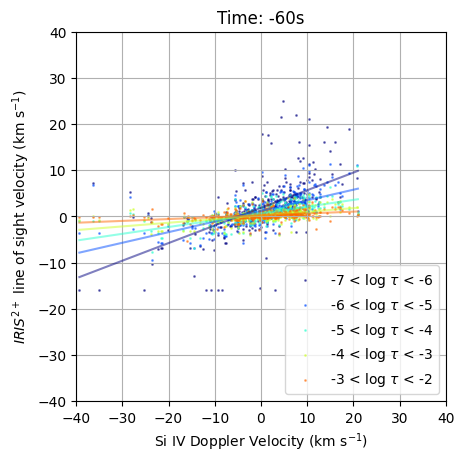

In [37]:
import matplotlib.animation as animation 
plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, ax = plt.subplots()
scatts = []
lin_fit = []

def get_xy(time, lgt):
    x = good_iris2p_moss.Si_IV_v_Dop.sel(time=time, method='nearest')
    y = good_iris2p_moss.v_los.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    ax.set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        x, y = get_xy(time, lgt)
        scatts[ii].set_offsets(np.array([x, y]).T)
        coeff = np.polyfit(x, y, 1)
        poly1d_fn = np.poly1d(coeff)
        xmin, xmax = (min(x), max(x))
        lin_fit[ii][0].set_data([xmin, xmax], poly1d_fn([xmin, xmax]))
        
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    scatts.append(scat)
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    p01 = ax.plot([xmin, xmax], poly1d_fn([xmin, xmax]), '-', color=colors[ii], alpha=0.5)
    lin_fit.append(p01)
    # print(rf'({lgt} < log $\tau $ < {lgt+1})  slope: {coeff[0]:6.2f}, $\rho$: {pearson_c:5.2f}')
ax.set(xlabel=x.attrs['label'], ylabel=y.attrs['label'], aspect='equal', title=f'Time: {time}s', 
      xlim=[-40, 40], ylim=[-40, 40], 
              )
ax.grid()
ax.legend(loc='lower right')

if False:
    ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
    ani.save(filename=save_path+'Si_dop_IRIS2p_dop_scatter.mp4', writer='ffmpeg', dpi=200, savefig_kwargs={'bbox_inches':'tight'})

animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
# fig.savefig('save_path'+'aaa.png', dpi=200, bbox_inches='tight')


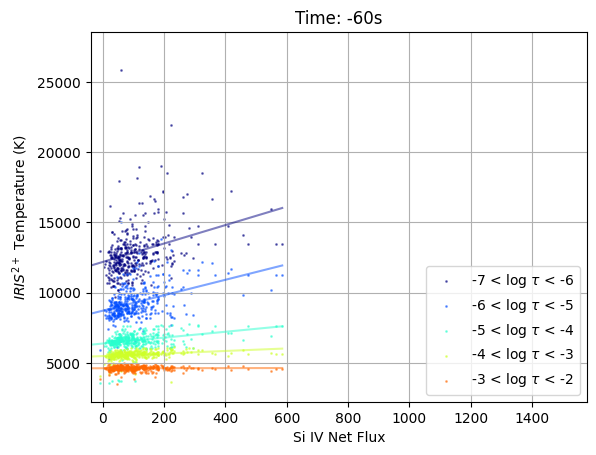

In [5]:
import matplotlib.animation as animation 
plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, ax = plt.subplots()
scatts = []
lin_fit = []

def get_xy(time, lgt):
    x = good_iris2p_moss.Si_IV_net_flux.sel(time=time, method='nearest')
    y = good_iris2p_moss.temperature.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    ax.set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        x, y = get_xy(time, lgt)
        scatts[ii].set_offsets(np.array([x, y]).T)
        coeff = np.polyfit(x, y, 1)
        poly1d_fn = np.poly1d(coeff)
        xmin, xmax = (min(x), max(x))
        lin_fit[ii][0].set_data([xmin, xmax], poly1d_fn([xmin, xmax]))
        
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    scatts.append(scat)
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    p01 = ax.plot([xmin, xmax], poly1d_fn([xmin, xmax]), '-', color=colors[ii], alpha=0.5)
    lin_fit.append(p01)
    # print(rf'({lgt} < log $\tau $ < {lgt+1})  slope: {coeff[0]:6.2f}, $\rho$: {pearson_c:5.2f}')
ax.set(xlabel=x.attrs['label'], ylabel=y.attrs['label'], aspect='auto', title=f'Time: {time}s', 
              # xlim=[4e3, 2e4], ylim=[0, 4e12], 
              )
ax.grid()
ax.legend(loc='lower right')
animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)

# ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
# ani.save(filename=save_path+'Si_netflux_iris2p_temp_scatter.mp4', writer='ffmpeg', dpi=200, savefig_kwargs={'bbox_inches':'tight'})



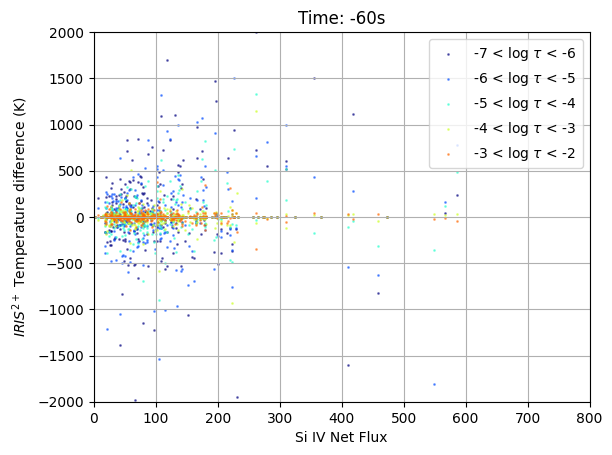

In [33]:
import matplotlib.animation as animation 
plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, ax = plt.subplots()
scatts = []

def get_xy(time, lgt):
    x = good_iris2p_moss.Si_IV_net_flux.sel(time=time, method='nearest')
    y = temp_diff.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    ax.set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        x, y = get_xy(time, lgt)
        scatts[ii].set_offsets(np.array([x, y]).T)

numframes = 10
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    scatts.append(scat)
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
ax.set(xlabel=x.attrs['label'], ylabel=y.attrs['label'], aspect='auto', title=f'Time: {time}s', 
              xlim=[0, 8e2], ylim=[-2e3, 2e3], 
              )
ax.grid()
ax.legend(loc='upper right')
# animate(30)
# animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)

ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani.save(filename=save_path+'Si_netflux_IRIS2p_tdiff_scatter.mp4', writer='ffmpeg', dpi=200, savefig_kwargs={'bbox_inches':'tight'})



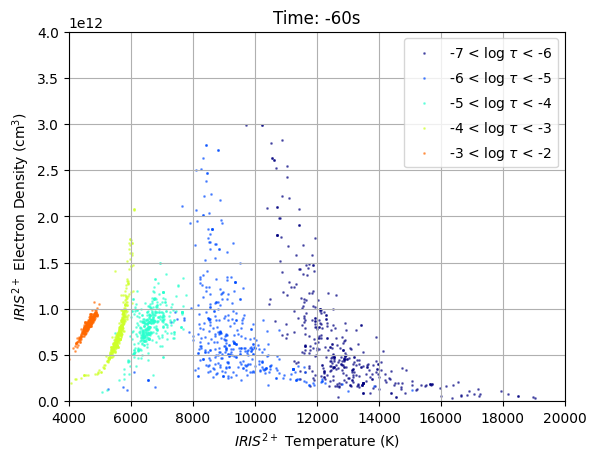

In [34]:
import matplotlib.animation as animation 
plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, ax = plt.subplots()
scatts = []

def get_xy(time, lgt):
    x = good_iris2p_moss.temperature.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    y = good_iris2p_moss.n_e.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    ax.set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        x, y = get_xy(time, lgt)
        scatts[ii].set_offsets(np.array([x, y]).T)

numframes = 10
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    scatts.append(scat)
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    # plt.plot([xmin, xmax], poly1d_fn([xmin, xmax]), '-', color=colors[ii], alpha=0.5)
    # print(rf'({lgt} < log $\tau $ < {lgt+1})  slope: {coeff[0]:6.2f}, $\rho$: {pearson_c:5.2f}')
ax.set(xlabel=x.attrs['label'], ylabel=y.attrs['label'], aspect='auto', title=f'Time: {time}s', 
              xlim=[4e3, 2e4], ylim=[0, 4e12], 
              )
ax.grid()
ax.legend()
# animate(30)
# animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani.save(filename=save_path+'temp_ne_scatter.mp4', writer='ffmpeg', dpi=200, savefig_kwargs={'bbox_inches':'tight'})


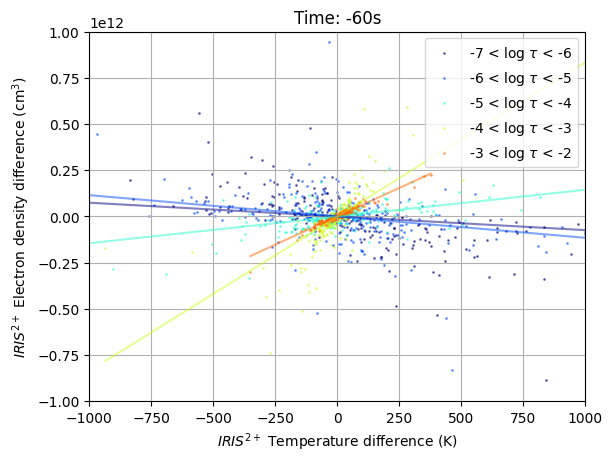

In [35]:
import matplotlib.animation as animation 
plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, ax = plt.subplots()
scatts = []
lin_fit = []

def get_xy(time, lgt):
    x = temp_diff.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    y = n_e_diff.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    ax.set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        x, y = get_xy(time, lgt)
        scatts[ii].set_offsets(np.array([x, y]).T)
        coeff = np.polyfit(x, y, 1)
        poly1d_fn = np.poly1d(coeff)
        xmin, xmax = (min(x), max(x))
        lin_fit[ii][0].set_data([xmin, xmax], poly1d_fn([xmin, xmax]))

numframes = 10
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    scatts.append(scat)
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    p01 = ax.plot([xmin, xmax], poly1d_fn([xmin, xmax]), '-', color=colors[ii], alpha=0.5)
    lin_fit.append(p01)
    # print(rf'({lgt} < log $\tau $ < {lgt+1})  slope: {coeff[0]:6.2f}, $\rho$: {pearson_c:5.2f}')
ax.set(xlabel=x.attrs['label'], ylabel=y.attrs['label'], aspect='auto', title=f'Time: {time}s', 
              xlim=[-1e3, 1e3], ylim=[-1e12, 1e12], 
              )
ax.grid()
ax.legend(loc='upper right')

# animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani.save(filename=save_path+'tdiff_nediff_scatter.mp4', writer='ffmpeg', dpi=200, savefig_kwargs={'bbox_inches':'tight'})


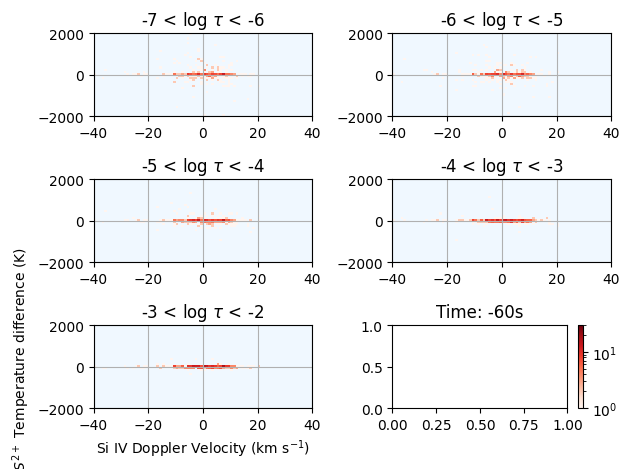

In [6]:
import matplotlib.animation as animation 
import matplotlib as mpl

plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1

time = 0
fig, axs = plt.subplots(3, 2)

def get_xy(time, lgt):
    x = good_iris2p_moss.Si_IV_v_Dop.sel(time=time, method='nearest')
    y = temp_diff.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    axs[5].set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        for child in axs[ii].get_children():
            if isinstance(child, mpl.collections.QuadMesh):
                child.remove()
        x, y = get_xy(time, lgt)
        hist2d = axs[ii].hist2d(x, y, bins=[np.arange(-40, 41, 1), np.arange(-2e3, 2.1e3, 1e2)], 
                      norm=mpl.colors.LogNorm(vmin=1, vmax=30), cmap='Reds') 
axs = axs.flatten()
numframes = 10
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    ax = axs[ii]
    ax.set(title=fr'{lgt} < log $\tau $ < {lgt+1}', facecolor='aliceblue')
    hist2d = ax.hist2d(x, y, bins=[np.arange(-40, 41, 1), np.arange(-2e3, 2.1e3, 1e2)], 
                      norm=mpl.colors.LogNorm(vmin=1, vmax=30), cmap='Reds') 
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    ax.set(xlim=[-40, 40], ylim=[-3e3, 3e3])
    ax.grid()
axs[4].set(xlabel=x.attrs['label'], ylabel=y.attrs['label'])
fig.colorbar(hist2d[-1], ax=axs[5])
plt.tight_layout()
animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)

# ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
# ani.save(filename=save_path+'tdiff_Si_vdop_2dhist.mp4', writer='ffmpeg', dpi=200)

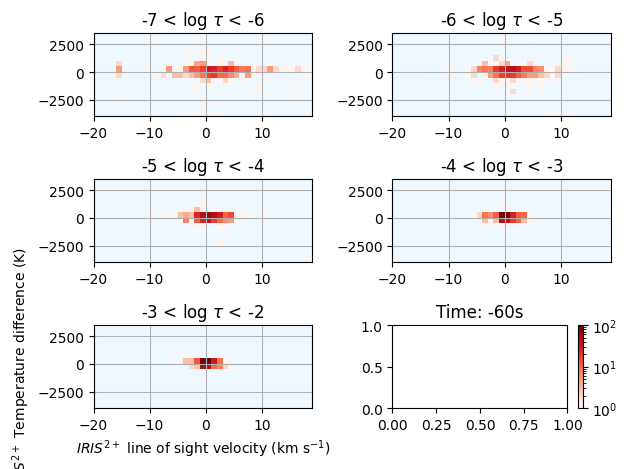

In [136]:
import matplotlib.animation as animation 
import matplotlib as mpl

plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1

colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, axs = plt.subplots(3, 2)
scatts = []

def get_xy(time, lgt):
    x = good_iris2p_moss.v_los.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    y = temp_diff.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    axs[5].set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        for child in axs[ii].get_children():
            if isinstance(child, mpl.collections.QuadMesh):
                child.remove()
        x, y = get_xy(time, lgt)
        # scatts[ii].set_offsets(np.array([x, y]).T)
        hist2d = axs[ii].hist2d(x, y, bins=[np.arange(-20, 20, 1), np.arange(-4e3, 4e3, 5e2)], 
                      norm=mpl.colors.LogNorm(vmin=1, vmax=100), cmap='Reds') 
axs = axs.flatten()
numframes = 10
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    ax = axs[ii]
    ax.set(title=fr'{lgt} < log $\tau $ < {lgt+1}', facecolor='aliceblue')
    # scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    # scatts.append(scat)
    hist2d = ax.hist2d(x, y, bins=[np.arange(-20, 20, 1), np.arange(-4e3, 4e3, 5e2)], 
                      norm=mpl.colors.LogNorm(vmin=1, vmax=100), cmap='Reds') 
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    ax.set(xlim=[-20, 20], ylim=[-4e3, 4e3])
    ax.grid()
axs[4].set(xlabel=x.attrs['label'], ylabel=y.attrs['label'])
fig.colorbar(hist2d[-1], ax=axs[5])
plt.tight_layout()
# animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)

ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani.save(filename=save_path+'_Si_vdop_2dhist.mp4', writer='ffmpeg', dpi=200)


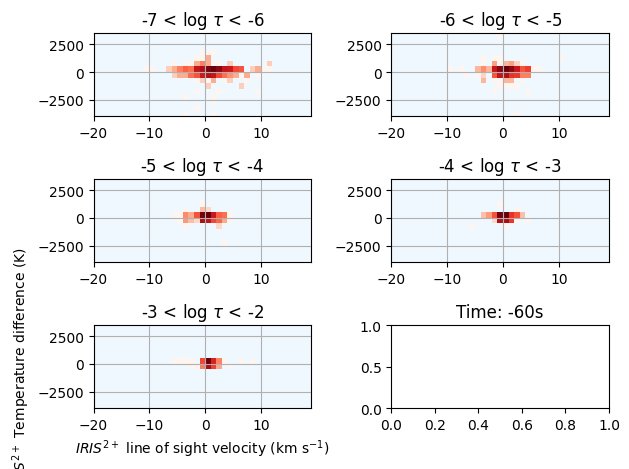

In [7]:
import matplotlib.animation as animation 
import matplotlib as mpl

plt.rcParams["animation.html"] = "jshtml"
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1

colors = cmap(np.linspace(0, 1, nlgt))
time = 0
fig, axs = plt.subplots(3, 2)
scatts = []

def get_xy(time, lgt):
    x = good_iris2p_moss.v_los.sel(time=time, method='nearest').sel(log_tau=slice(lgt+1, lgt+2)).mean(dim='log_tau')
    y = temp_diff.sel(time=time, method='nearest').sel(log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    return x[idx], y[idx]

def animate(time):
    axs[5].set_title(f'Time: {time}s')
    for ii, lgt in enumerate(range(lgt_min, lgt_max)):
        for child in axs[ii].get_children():
            if isinstance(child, mpl.collections.QuadMesh):
                child.remove()
        x, y = get_xy(time, lgt)
        # scatts[ii].set_offsets(np.array([x, y]).T)
        hist2d = axs[ii].hist2d(x, y, bins=[np.arange(-20, 20, 1), np.arange(-4e3, 4e3, 5e2)], 
                  norm='log', cmap='Reds')     
axs = axs.flatten()
numframes = 10
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x, y = get_xy(time, lgt)
    ax = axs[ii]
    ax.set(title=fr'{lgt} < log $\tau $ < {lgt+1}', facecolor='aliceblue')
    # scat = ax.scatter(x, y, s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    # scatts.append(scat)
    hist2d = ax.hist2d(x, y, bins=[np.arange(-20, 20, 1), np.arange(-4e3, 4e3, 5e2)], 
                      norm=mpl.colors.LogNorm(vmin=1, vmax=1e3), cmap='Reds') 
    coeff = np.polyfit(x, y, 1)
    pearson_c = stats.pearsonr(x, y).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x), max(x))
    ax.set(xlim=[-20, 20], ylim=[-4e3, 4e3])
    ax.grid()
axs[4].set(xlabel=x.attrs['label'], ylabel=y.attrs['label'])
# fig.colorbar(hist2d[-1], ax=axs[5])
plt.tight_layout()
# animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani = animation.FuncAnimation(fig, animate, frames=range(-60, 60, 2), interval=1e2)
ani.save(filename=save_path+'vlos_Si_vdop_2dhist.mp4', writer='ffmpeg', dpi=200)

(-7 < log $\tau $ < -6)  slope:  -0.00, $\rho$: -0.50
(-6 < log $\tau $ < -5)  slope:  -0.00, $\rho$: -0.40
(-5 < log $\tau $ < -4)  slope:   0.00, $\rho$:  0.25
(-4 < log $\tau $ < -3)  slope:   0.00, $\rho$:  0.77
(-3 < log $\tau $ < -2)  slope:   0.00, $\rho$:  0.94


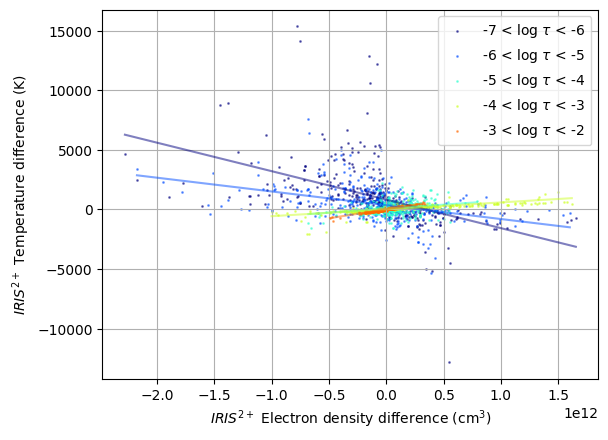

In [154]:
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x = n_e_diff.sel(time=0, log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    y = temp_diff.sel(time=0, log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    plt.scatter(x[idx], y[idx], 
                s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    coeff = np.polyfit(x[idx], y[idx], 1)
    pearson_c = stats.pearsonr(x[idx], y[idx]).statistic
    poly1d_fn = np.poly1d(coeff)
    xmin, xmax = (min(x[idx]), max(x[idx]))
    plt.plot([xmin, xmax], poly1d_fn([xmin, xmax]), '-', color=colors[ii], alpha=0.5)
    print(rf'({lgt} < log $\tau $ < {lgt+1})  slope: {coeff[0]:6.2f}, $\rho$: {pearson_c:5.2f}')
plt.gca().set(xlabel=x.attrs['label'], ylabel=y.attrs['label'], aspect='auto', 
              # xlim=[0, 800], ylim=[-5000, 5000], 
              )
plt.grid()
plt.legend()


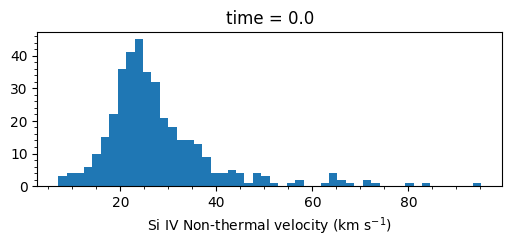

In [142]:
dum = good_iris2p_moss.Si_IV_v_nth.sel(time=0)
_ = dum.plot.hist(bins=50, figsize=(6, 2))
_ = plt.gca().set(xlabel=dum.attrs['label'])
_ = plt.minorticks_on()


In [13]:
coeff

array([0.01364481, 1.93509217])

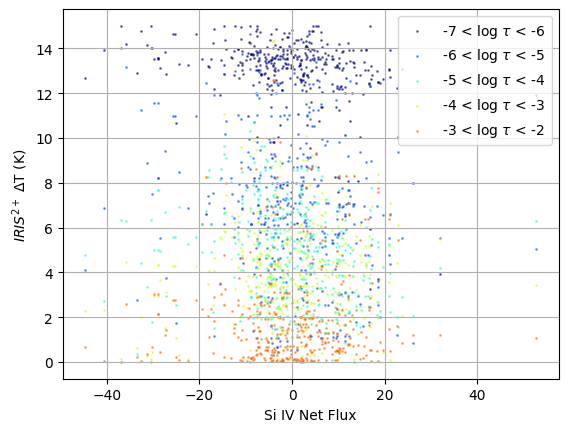

In [57]:
lgt_min = -7
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
temp_diff = (good_iris2p_moss.temperature - good_iris2p_moss.temperature.sel(time=slice(-60, -50)).mean(dim='time'))

for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    x = good_iris2p_moss.Si_IV_v_Dop.sel(time=0)
    y = good_iris2p_moss.v_tur.sel(time=0, log_tau=slice(lgt, lgt+1)).mean(dim='log_tau')
    idx = np.isfinite(x) & np.isfinite(y)
    plt.scatter(x[idx], y[idx], 
                s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    coeff = np.polyfit(x[idx], y[idx], 1)
    poly1d_fn = np.poly1d(coeff)
    # plt.plot([-100, 100], poly1d_fn([-100, 100]), '-', color=colors[ii], alpha=0.5)
plt.gca().set(xlabel='Si IV Net Flux', ylabel=iris2p_str+r' $\Delta$T (K)', 
             aspect='auto')
plt.grid()
plt.legend()

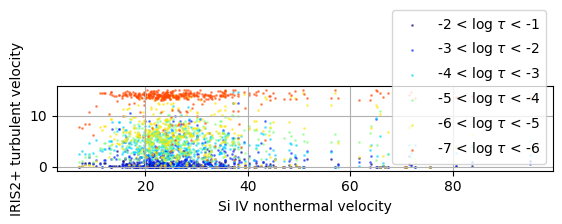

In [66]:
lgt_min = -8
lgt_max = -2
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
for ii, lgt in enumerate(range(lgt_max, lgt_min, -1)):
    mg_ii_log_tau = (good_iris2p_moss.log_tau > lgt)*(good_iris2p_moss.log_tau < lgt+1)
    mg_ii_dop = good_iris2p_moss.v_tur.sel(time=0).isel(log_tau=mg_ii_log_tau).mean(dim=['log_tau'])
    x = good_iris2p_moss.Si_IV_v_nth.sel(time=0)
    y = mg_ii_dop
    idx = np.isfinite(x) & np.isfinite(y)
    plt.scatter(x[idx], y[idx], 
                s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    # coeff = np.polyfit(x[idx], y[idx], 1)
    # poly1d_fn = np.poly1d(coeff)
    # plt.plot([-100, 100], poly1d_fn([-100, 100]), '-', color=colors[ii], alpha=0.5)
plt.gca().set(xlabel='Si IV nonthermal velocity', ylabel='IRIS2+ turbulent velocity', 
             aspect='equal')
plt.grid()
plt.legend()

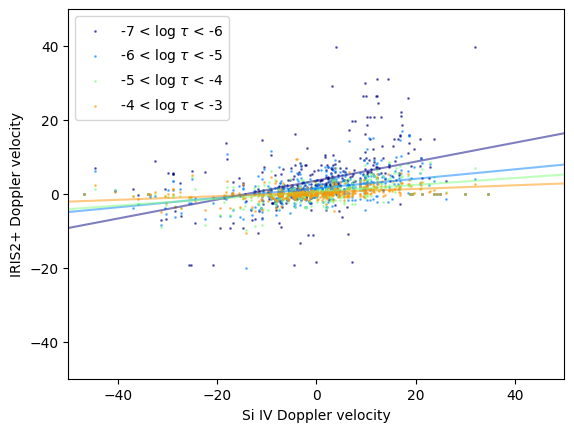

In [48]:
lgt_min = -7
lgt_max = -3
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    iris2p_log_tau = (good_iris2p_moss.log_tau > lgt)*(good_iris2p_moss.log_tau < lgt+1)
    iris2p_dop = good_iris2p_moss.v_los.sel(time=0).isel(log_tau=iris2p_log_tau).mean(dim=['log_tau'])
    iris2p_t = good_iris2p_moss.temperature.sel(time=0).isel(log_tau=iris2p_log_tau).mean(dim=['log_tau'])
    iris2p_t0 = good_iris2p_moss.temperature.sel(time=-60).isel(log_tau=iris2p_log_tau).mean(dim=['log_tau'])
    y = iris2p_dop
    x = good_iris2p_moss.Si_IV_v_Dop.sel(time=0)
    # y = mg_ii_t
    idx = np.isfinite(x) & np.isfinite(y)
    plt.scatter(x[idx], y[idx], 
                s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    coeff = np.polyfit(x[idx], y[idx], 1)
    poly1d_fn = np.poly1d(coeff)
    plt.plot([-100, 100], poly1d_fn([-100, 100]), '-', color=colors[ii], alpha=0.5)
plt.gca().set(xlabel='Si IV Doppler velocity', ylabel='IRIS2+ Doppler velocity', xlim=[-50, 50], ylim=[-50, 50])
plt.legend()

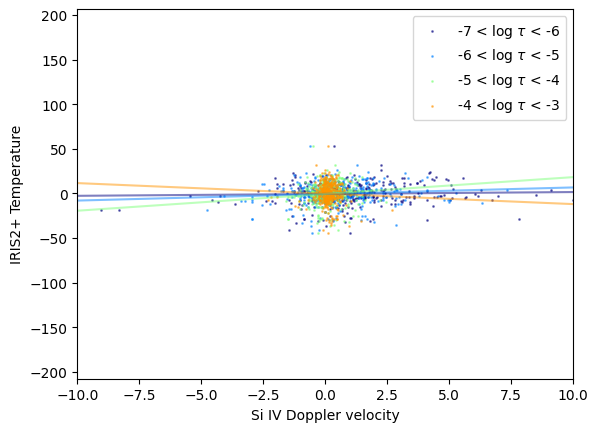

In [43]:
lgt_min = -7
lgt_max = -3
nlgt = lgt_max - lgt_min + 1
cmap = mpl.colormaps['jet']
colors = cmap(np.linspace(0, 1, nlgt))
for ii, lgt in enumerate(range(lgt_min, lgt_max)):
    iris2p_log_tau = (good_iris2p_moss.log_tau > lgt)*(good_iris2p_moss.log_tau < lgt+1)
    iris2p_dop = good_iris2p_moss.v_los.sel(time=0).isel(log_tau=iris2p_log_tau).mean(dim=['log_tau'])
    iris2p_t = good_iris2p_moss.temperature.sel(time=0).isel(log_tau=iris2p_log_tau).mean(dim=['log_tau'])
    iris2p_t0 = good_iris2p_moss.temperature.sel(time=-60).isel(log_tau=iris2p_log_tau).mean(dim=['log_tau'])
    x = iris2p_t - iris2p_t0
    y = good_iris2p_moss.Si_IV_v_Dop.sel(time=0)
    # y = mg_ii_t
    idx = np.isfinite(x) & np.isfinite(y)
    plt.scatter(x[idx], y[idx], 
                s=1, color=colors[ii], alpha=0.5, label=fr'{lgt} < log $\tau $ < {lgt+1}') 
    coeff = np.polyfit(x[idx], y[idx], 1)
    poly1d_fn = np.poly1d(coeff)
    plt.plot([-100, 100], poly1d_fn([-100, 100]), '-', color=colors[ii], alpha=0.5)
plt.gca().set(xlabel='Si IV Doppler velocity', ylabel='IRIS2+ Temperature', xlim=[-10, 10])
plt.legend()